<h1>CS4619: Artificial Intelligence II</h1>
<h1>Interpretability of Neural Networks</h1>
<h2>
    Derek Bridge<br>
    School of Computer Science and Information Technology<br>
    University College Cork
</h2>

<h1>Initialization</h1>
$\newcommand{\Set}[1]{\{#1\}}$ 
$\newcommand{\Tuple}[1]{\langle#1\rangle}$ 
$\newcommand{\v}[1]{\pmb{#1}}$ 
$\newcommand{\cv}[1]{\begin{bmatrix}#1\end{bmatrix}}$ 
$\newcommand{\rv}[1]{[#1]}$ 
$\DeclareMathOperator{\argmax}{arg\,max}$ 
$\DeclareMathOperator{\argmin}{arg\,min}$ 
$\DeclareMathOperator{\dist}{dist}$
$\DeclareMathOperator{\abs}{abs}$

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [25]:
import tensorflow as tf

from tensorflow.keras.preprocessing.image import load_img, img_to_array

from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.applications.vgg16 import decode_predictions

from tensorflow.keras.models import Model

import cv2

<h1>Acknowledgments</h1> 
<ul>
    <li>I have used code from the following two sources:
        <ul>
            <li>Some of the code is adapted from code in: 
        Fran&ccedil;ois Chollet: <i>Deep Learning with Python</i>,
        Manning Publications, 2018
            </li>
            <li>Other code is adapted from <a href="https://www.sicara.ai/blog/2019-08-28-interpretability-deep-learning-tensorflow">https://www.sicara.ai/blog/2019-08-28-interpretability-deep-learning-tensorflow</a>
            </li>
        </ul>
        The result is a bit of a mess! Sorry!
    </li>
    <li>The figures comes from the paper <i>Explainable Artificial Intelligence (XAI): Concepts,
        Taxonomies, Opportunities and Challenges toward Responsible AI</i> by Arrieta et al, 2019</li>
</ul>

<h1>Warnings</h1>
<ul>
    <li>One of the visualizations can takes several hours to run.</li>
    <li>One of the visualizations requires another Python library. if you want to run this noteboook, you would need to activate your virtual environment and then install this extra library as follows:
        <pre>
        python3 -m pip install -U opencv-python
        </pre>
    </li>
</ul>

<h1>Introduction: XAI</h1>
<ul>
    <li>As soon as AI systems began to be used in real applications, there was interest in getting them
        to explain their reasoning.
    </li>
    <li>But with recent successes in deploying Machine Learning systems, there has been an explosion of
        interest.
        <ul>
            <li>Related terminology includes: XAI (eXplainable AI), interpretability, intelligibility,
                transparency, &hellip;
            </li>
        </ul>
    </li>
    <li>Different stakeholders may have different goals that they hope XAI will satisfy:
        <img src="images/XAI_stakeholders.png" />
    </li>
</ul>

<h2>XAI: Some Distinctions</h2>
<ul>
    <li>Local explanations vs. global explanations:
        <ul>
            <li><b>local:</b> explaining an individual prediction;</li>
            <li><b>global:</b> explaining the whole model ('intelligibility') &mdash; what has it learned</li>
        </ul>
    </li>
    <li>White-box models vs. black-box models:
        <ul>
            <li><b>white-box models:</b> models that are considered interpretable due to their simple structure, 
                such as small decision trees or sparse linear models;
            </li>
            <li><b>black-box models:</b> models which are not easily understood, e.g. neural networks and 
                ensembles such as Random Forests.
            </li>
        </ul>
    </li>
    <li>Model-specific methods vs. model-agnostic methods:
        <ul>
            <li><b>model-specific methods</b>: methods for producing explanations that only work for certain kinds
                of model, e.g. methods that only apply to convolutional neural networks;
            </li>
            <li><b>model-agnostic methods</b>: methods for producing explanations that work for a wide class of
                model, e.g. methods that can work for decision trees, Random Forests and neural networks.
            </li>
        </ul>
    </li>
</ul>

<h2>Accuracy/Intelligibility Trade-Off</h2>
<ul>
    <li>This image is from a presentation by David Gunning of DARPA:
        <img src="images/XAI_DARPA.png" />
    </li>
    <li>The goal of DAPRA's XAI Research Programme is to develop models that are more easily
        explained but without sacrificing accuracy.
    </li>
</ul>

<h2>Visualizing Neural Networks</h2>
<ul>
    <li>Let's look at some examples of the simpler work that has been done to make neural networks
        more intelligible, especially in the case of neural networks for images.
    </li>
    <li>This involves various kinds of visualizations. We will look at three.</li>
    <li>You do not have to understand the code!</li>
    <li>We will run these visualizations on an ImageNet neural network called VGG16 (smaller than ResNet50).</li>
</ul>

In [26]:
vgg16_base = VGG16(weights="imagenet", include_top=False, input_shape=(224, 224, 3))

58892288/58889256 [==============================] - 6s 0us/step


In [27]:
vgg16 = VGG16(weights="imagenet", include_top=True)

553467904/553467096 [==============================] - 66s 0us/step


In [28]:
vgg16.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

<ul>
    <li>In the rest of this lecture, we'll just work with the cat image that we used in a previous lecture</li>
</ul>

In [29]:
img_path = "../datasets/dataset_wikipedia_images/img1.jpg"
img = load_img(img_path, target_size=(224, 224))
img_tensor = img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
img_tensor = preprocess_input(img_tensor)

<h3>Visualizing Convolutional Layer Activations</h3>
<ul>
    <li>For a given input image, we can visualize the activations of each of the the feature maps in a given convolutional
        layer.
    </li>
    <li>This will help show the kind of feature that the feature map is detecting.</li>
</ul>

In [32]:
# Create a model that outputs the activations of the convolutional and pooling layers of the VGG16 model
layer_outputs = [layer.output for layer in vgg16_base.layers[1:19]]
activation_model = Model(inputs=vgg16_base.input, outputs=layer_outputs)

In [33]:
# A function to plot the activation a given feature map within a given layer on a given input tensor
def plot_activation(activation_model, layer_idx, map_idx, img_tensor):
    # Run the model on the input tensor
    model_activations = activation_model.predict(img_tensor)
    # The activation of the given layer
    layer_activation = model_activations[layer_idx]
    # The activation of a given feature map in the layer
    map_activation = layer_activation[0, :, :, map_idx]
    # Plot
    plt.matshow(map_activation, cmap="viridis")

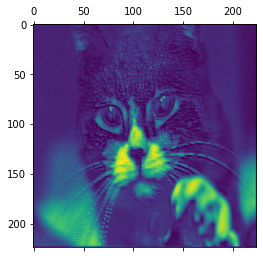

In [34]:
# Now we can plot the activation of, e.g., the fourth feature map in the first convolutional layer
plot_activation(activation_model, 1, 4, img_tensor)

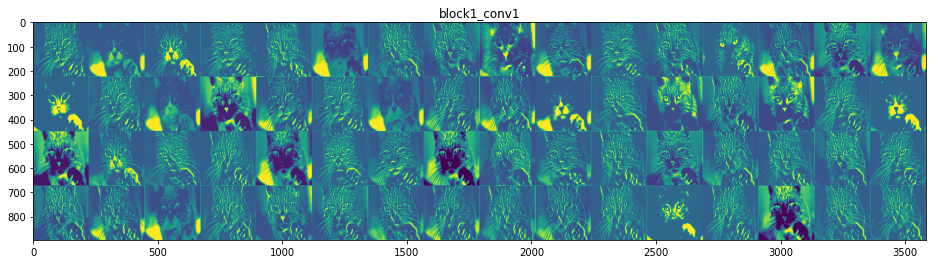

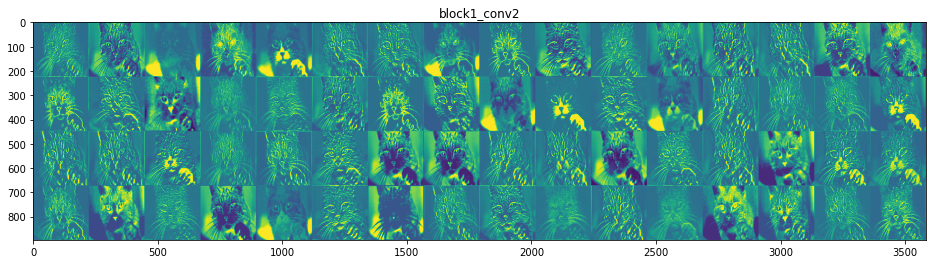

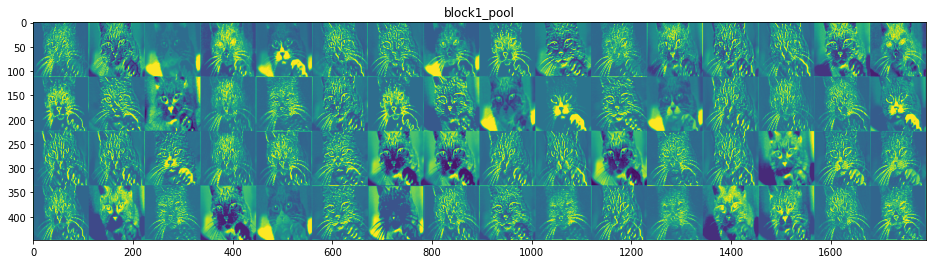

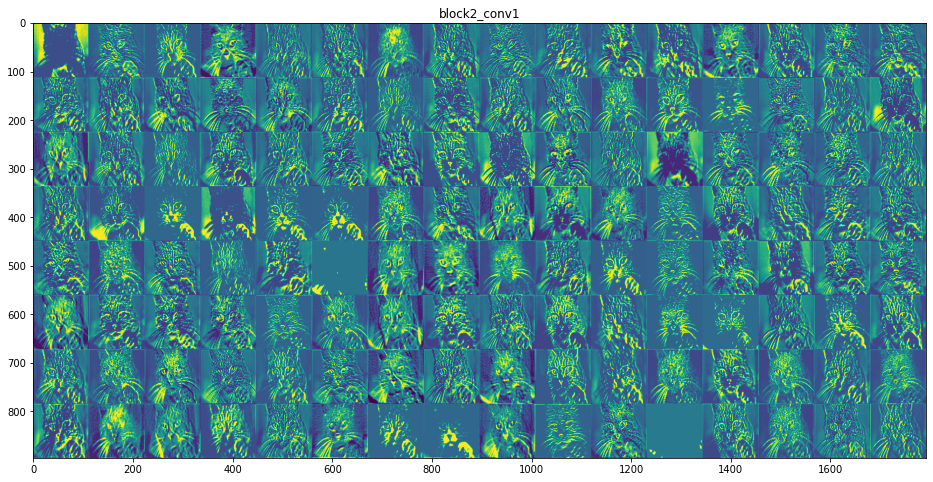

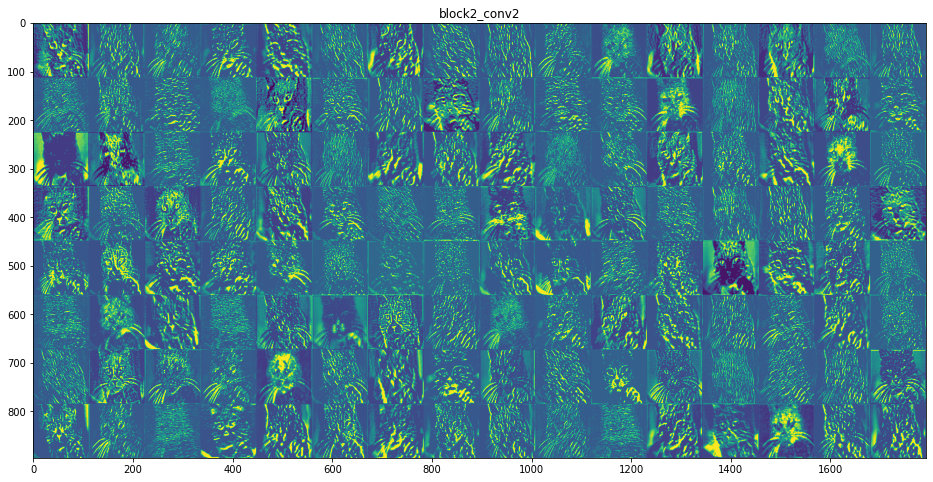

...

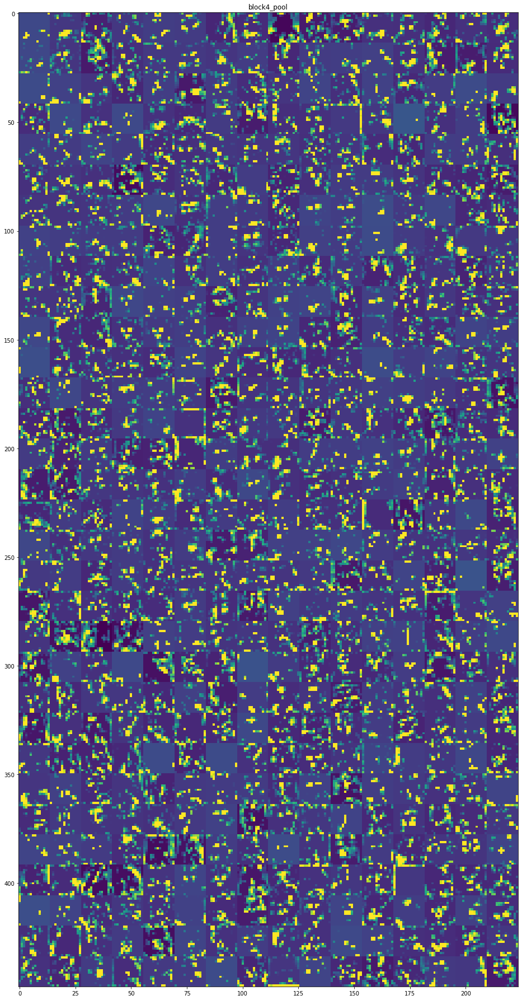

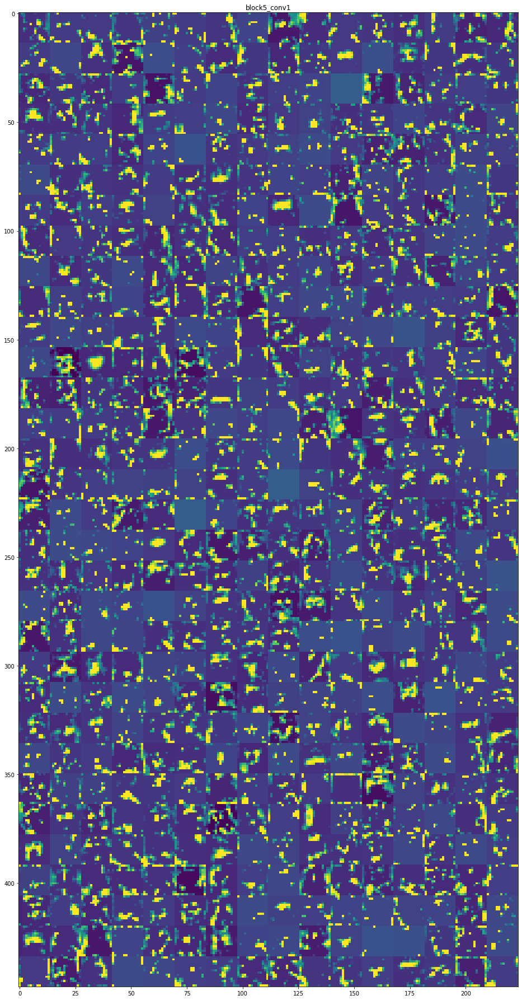

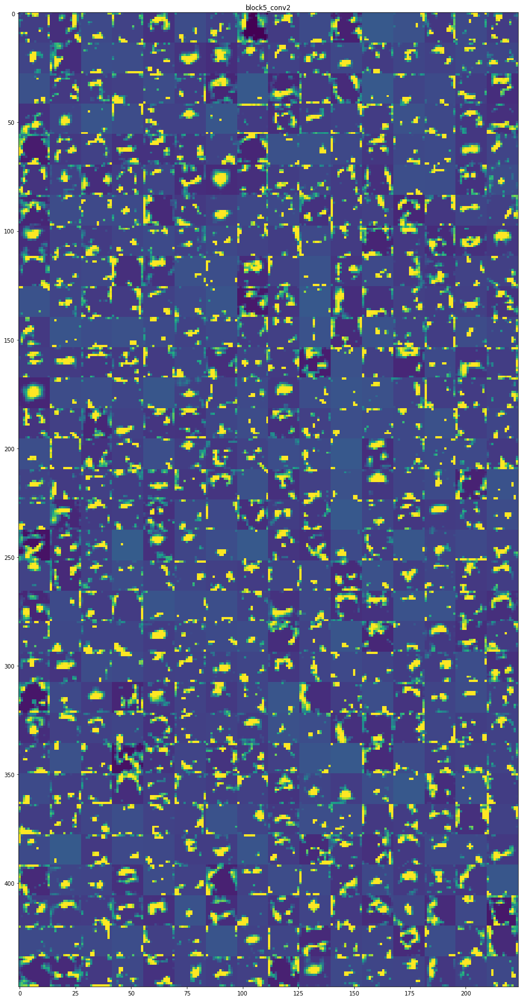

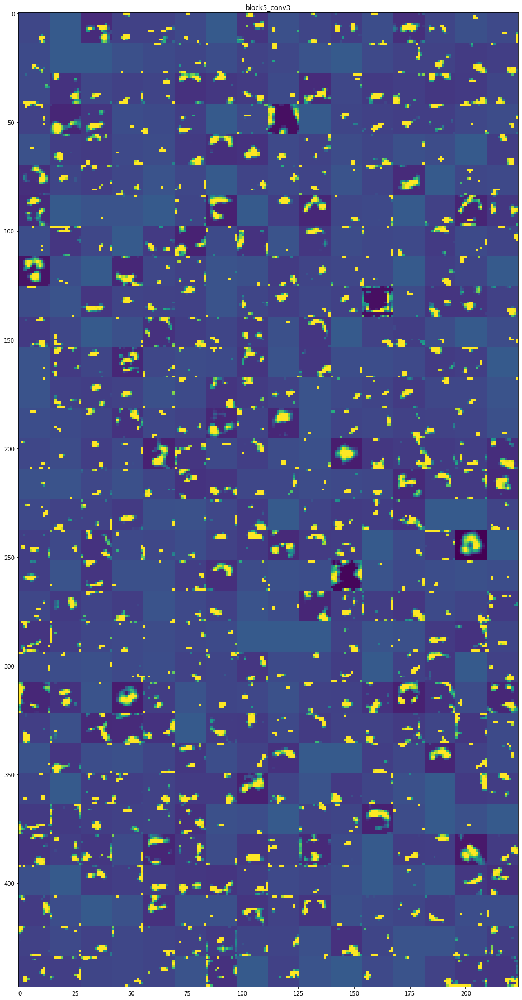

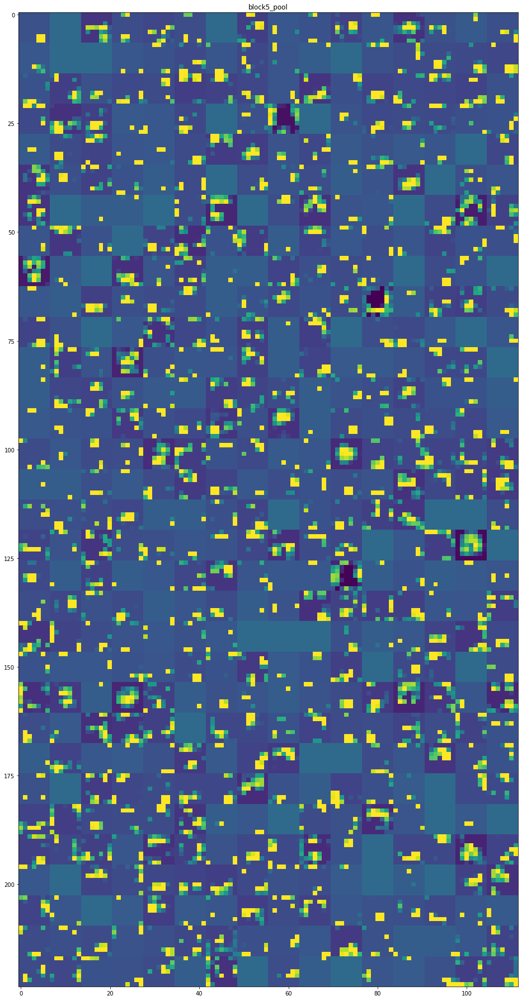

In [35]:
# Now a visualization of all activations of all feature maps in all convolutional and pooling layers

# Run the model on the input tensor
activations = activation_model.predict(img_tensor)

# Get the names of the layers, to label the visualization
layer_names = []
for layer in activation_model.layers[1:19]:
    layer_names.append(layer.name)

images_per_row = 16

# Now let's display our feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # We will tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    
    # We'll tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= (channel_image.std() + 1e-5)
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype("uint8")
            #channel_img = improve_image(channel_image)
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image
    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect="auto", cmap="viridis")
    
plt.show()

<ul>
    <li>Lower layers are edge dectectors and, because these edges are common, there is a lot of activation,
        retaining a lot of the image.
    </li>
    <li>Higher in the network, features become more abstract and hence activation is less about the image
        and more about the class.
    </li>
    <li>In higher layers, there are increasing cases of no activation, meaning the feature is not present
        at all.
    </li>
</ul>

<h3>Visualizing Convolutional Layer Inputs that Maximize Activations</h3>
<ul>
    <li>In this visualization, we display the kinds of inputs that feature maps respond to.</li>
    <li>This is done by gradient ascent on the input space: 
        <ul>
            <li>start from a blankish input image;</li>
            <li>finds the changes to the input that maximise the response of a feature map.</li>
        </ul>
    </li>
</ul>

In [36]:
def improve_image(img):
    # normalize tensor: center on 0., ensure std is 0.1
    img -= img.mean()
    img /= (img.std() + 1e-5)
    img *= 0.1

    # clip to [0, 1]
    img += 0.5
    img = np.clip(img, 0, 1)

    # convert to RGB array
    img *= 255
    img = np.clip(img, 0, 255).astype("uint8")
    return img

In [37]:
epochs = 100
step_size = 1.

def inspect_map(model, layer_name, map_idx):
    # Create a connection between the input and the target layer
    submodel = tf.keras.models.Model([model.inputs[0]], [model.get_layer(layer_name).output])

    # Initiate random noise
    input_img_data = np.random.random((1, 224, 224, 3))
    input_img_data = (input_img_data - 0.5) * 20 + 128.

    # Cast random noise from np.float64 to tf.float32 Variable
    input_img_data = tf.Variable(tf.cast(input_img_data, tf.float32))

    # Iterate gradient ascents
    for _ in range(epochs):
        with tf.GradientTape() as tape:
            outputs = submodel(input_img_data)
            loss_value = tf.reduce_mean(outputs[:, :, :, map_idx])
        grads = tape.gradient(loss_value, input_img_data)
        normalized_grads = grads / (tf.sqrt(tf.reduce_mean(tf.square(grads))) + 1e-5)
        input_img_data.assign_add(normalized_grads * step_size)
    
    return improve_image(input_img_data.numpy()[0])

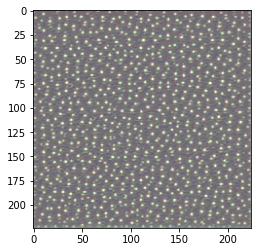

In [38]:
# E.g. inspect feature map 0 of the block3_conv layer
model = tf.keras.applications.vgg16.VGG16(weights='imagenet', include_top=True)
img = inspect_map(model, 'block3_conv1', 0)
plt.imshow(img, cmap="viridis")

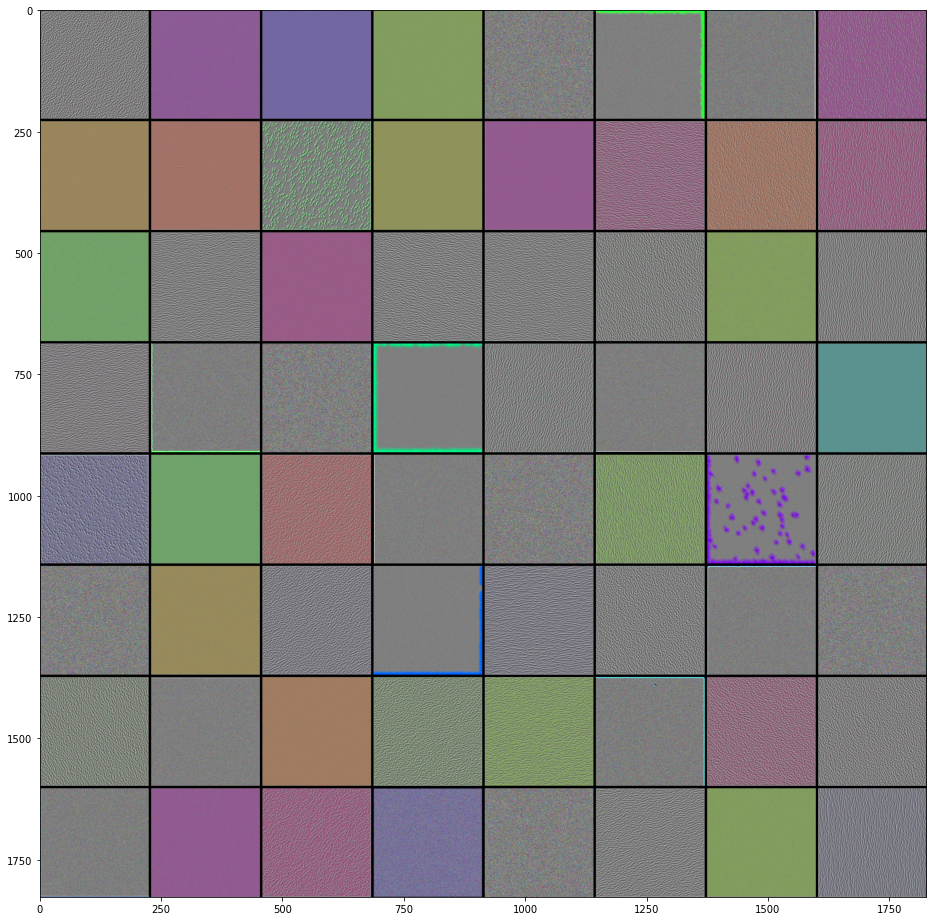

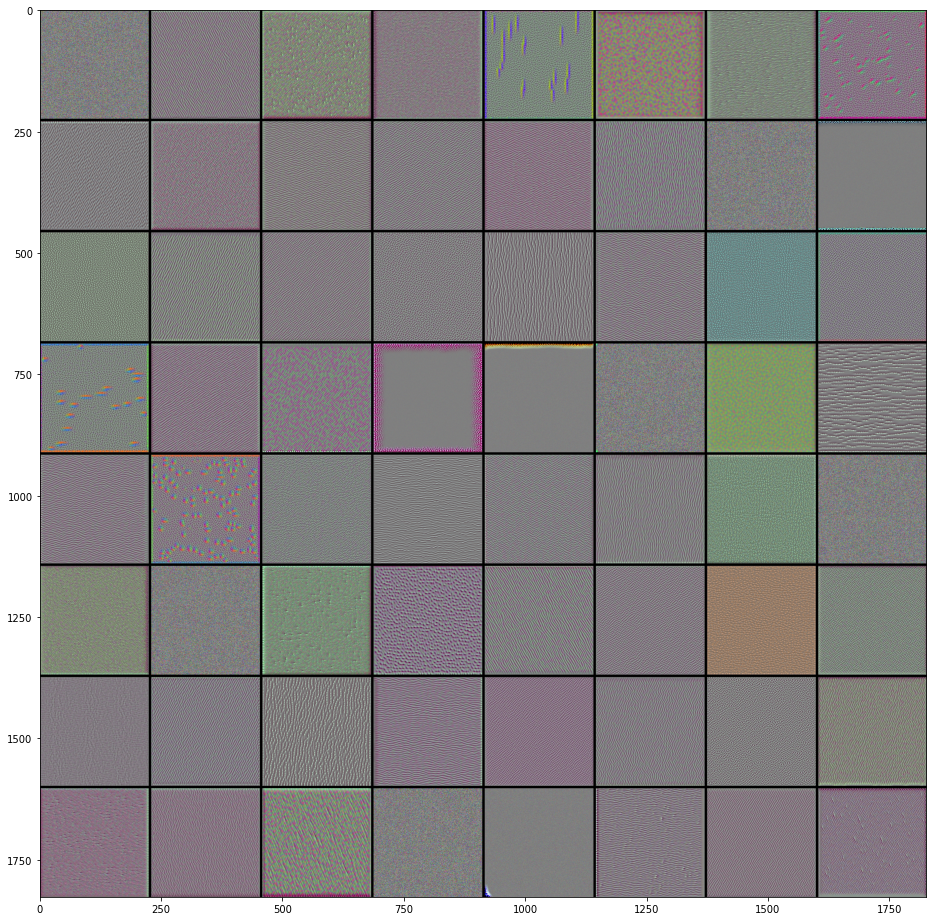

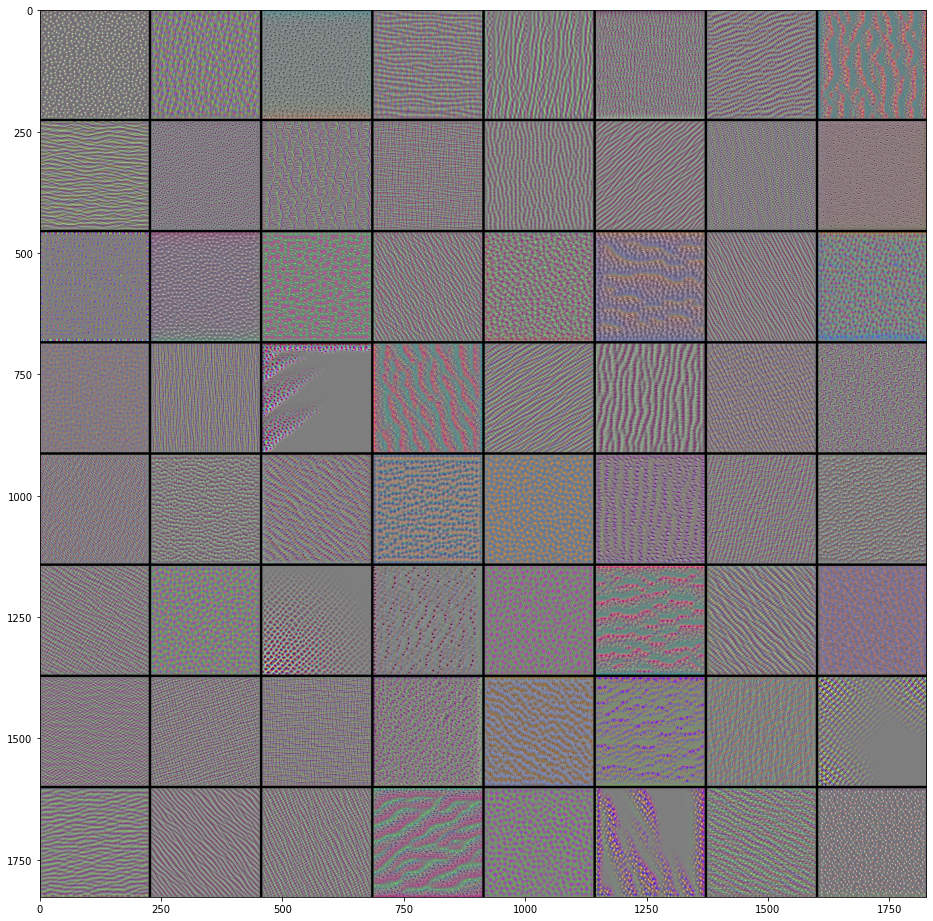

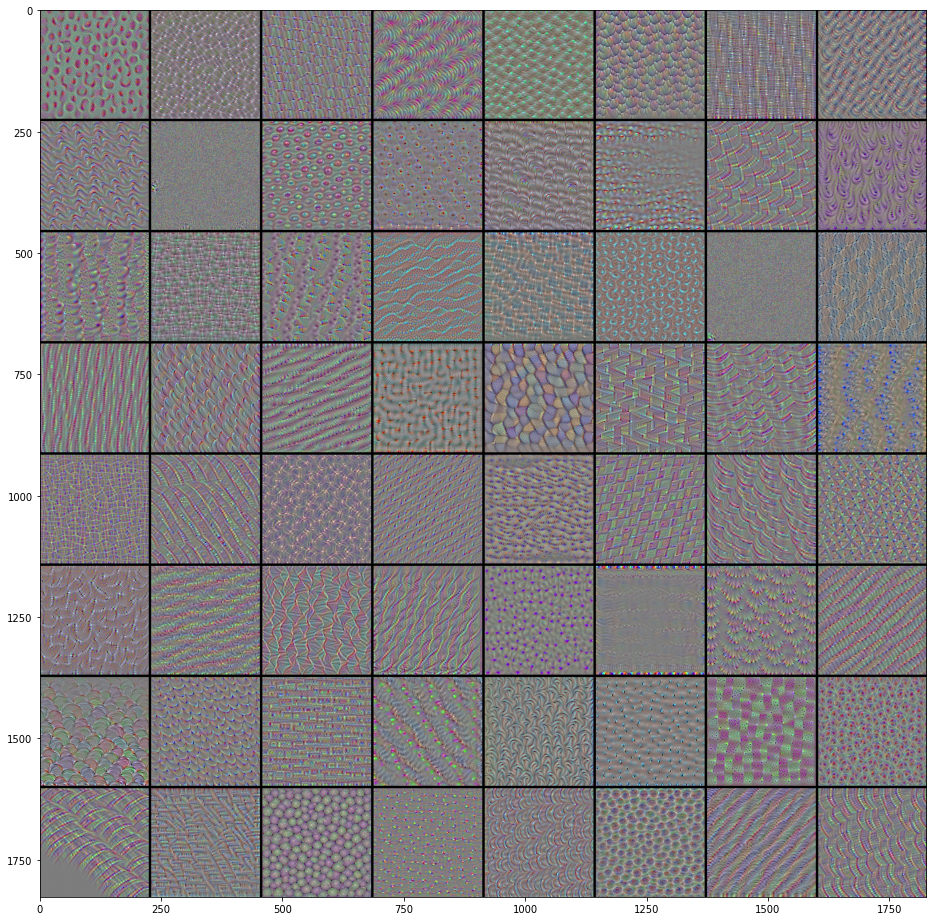

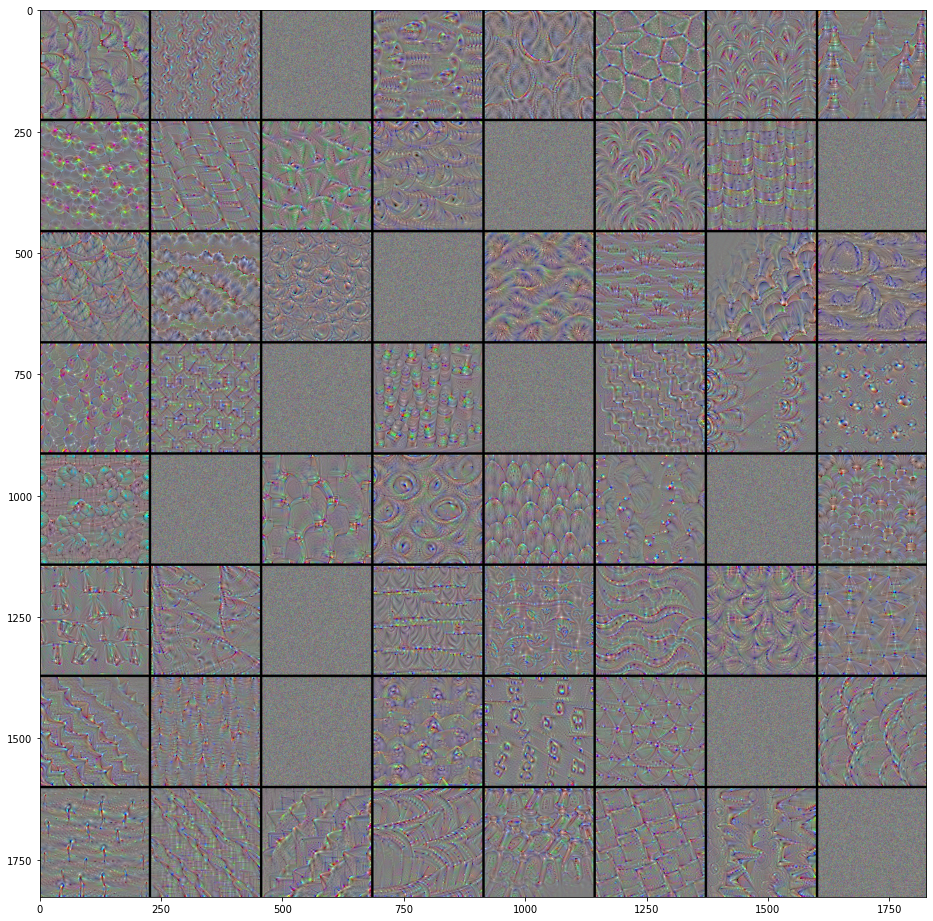

In [39]:
# Now visualize the first 64 feature maps of each convolutional layer (not the pooling layers)
for layer_name in ["block1_conv1", "block2_conv1", "block3_conv1", "block4_conv1", "block5_conv1"]:
    size = 224
    margin = 5

    # This a empty (black) image where we will store our results.
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3)).astype("uint8")

    for i in range(8):  # iterate over the rows of our results grid
        for j in range(8):  # iterate over the columns of our results grid
            # Generate the pattern for filter `i + (j * 8)` in `layer_name`
            filter_image = inspect_map(model, layer_name, i + (j * 8))
            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_image
        
    # Display the results grid
    scale = 2. / size
    plt.figure(figsize=(scale * results.shape[1],
                        scale * results.shape[0]))
    plt.imshow(results, cmap="viridis")
    plt.show()

<ul>
    <li>The feature maps in block1_conv1 respond to simple edges and colours.</li>
    <li>The feature maps in block2_conv1 respond to simple textures made from combinations of edges and
        colours.
    </li>
    <li>The feature maps in later layers respond to natural-looking textures resembling feathers, leaves, etc.
    </li>
</ul>

<h3>Visualizing Heatmaps for Classifications</h3>
<ul>
    <li>For a given input image and a predicted class, this will show which
        parts of the image were most useful in making the classification.
        <ul>
            <li>For every pixel, we compute a score indicating how important that pixel is
                in predicting the class.
            </li>
            <li>We display the scores as a heatmap.</li>
            <li>This can be helpful in debugging models: we
                can see whether the model is paying attention to the 'right' parts of the image.
            </li>
        </ul>
    </li>
</ul>

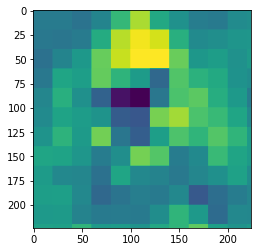

In [41]:
# Create function to apply a grey patch on an image
def apply_grey_patch(image, top_left_x, top_left_y, patch_size):
    patched_image = np.array(image, copy=True)
    #patched_image[top_left_y:top_left_y + patch_size, top_left_x:top_left_x + patch_size, :] = 127.5
    patched_image[top_left_x:top_left_x + patch_size, top_left_y:top_left_y + patch_size, :] = 127.5

    return patched_image

# Recall the predictions for our img_tensor
preds = vgg16.predict(img_tensor) 
# Get the index of the output unit that was most highly activated
output_unit_idx = np.argmax(preds[0])
class_index = output_unit_idx 
patch_size = 20 

sensitivity_map = np.zeros((img_tensor.shape[1], img_tensor.shape[2]))

# Iterate the patch over the image
for top_left_x in range(0, img_tensor.shape[1], patch_size):
    for top_left_y in range(0, img_tensor.shape[2], patch_size):
        patched_image = apply_grey_patch(img_tensor[0], top_left_x, top_left_y, patch_size)
        predicted_classes = model.predict(np.array([patched_image]))[0] 
        confidence = predicted_classes[class_index]
        # Save confidence for this specific patched image in map
        sensitivity_map[
            top_left_x:top_left_x + patch_size,
            top_left_y:top_left_y + patch_size,
        ] = confidence

plt.imshow(sensitivity_map)

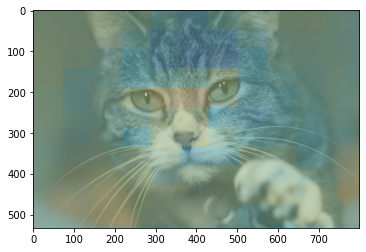

In [42]:
# Generate a new image that superimposes the original on the sensitivity map
# NB Requires OpenCV

# We use cv2 to load the original image
img = cv2.imread(img_path)

# We resize the heatmap to have the same size as the original image
sensitivity_map = cv2.resize(sensitivity_map, (img.shape[1], img.shape[0]))

# We convert the heatmap to RGB
sensitivity_map = np.uint8(255 * sensitivity_map)

# We apply the heatmap to the original image
sensitivity_map = cv2.applyColorMap(sensitivity_map, cv2.COLORMAP_JET)

# 0.4 here is a heatmap intensity factor
superimposed_img = sensitivity_map * 0.4 + img

plt.imshow(improve_image(superimposed_img))

<ul>
    <li>This image shows us why the model thinks the image contains a cat and where in the image
        it thinks the cat is located.
    </li>
</ul>

<h2>Model-Agnostic Methods</h2>
<ul>
    <li>The methods we looked at above are model-specific: they only work for a certain kind of model (convolutional
        neural networks).
    </li>
    <li>The great advantage of model-agnostic methods, on the other hanbd, is their flexibility: they can be used with a wide
        range of models, including Black-Box Models.
    </li>
    <li>Their great weakness is: they cannot refer to the model itself or its operation, so are they really
        explaining the model's prediction at all?
    </li>
    <li>Let's consider several model-agnostic methods. We'll describe them only in very high-level terms. 
        In each case, 
        <ul>
            <li>Assume we have learned a classification model $M$ from some training data.</li>
            <li>We have been given an object $\v{x}$.</li>
            <li>Model $M$ predicts the class of $\v{x}$ to be $\hat{y}$.</li>
            <li>But the user asks us to explain this prediction.</li>
        </ul>
    </li>
</ul>
<h3>LIME</h3>
<ul>
    <li>LIME takes $\v{x}$ and 'peturbs' it (i.e. modifies the values of its features a little bit) to create
        a set of objects that are similar to $\v{x}$. Call this set of examples $S$.
    </li>
    <li>Then it uses $M$ to predict the class of each example in $S$.</li>
    <li>Then it treats $S \cup \{\v{x}\}$ (with their predicted labels) as the training data for a linear
        model (logistic regression).
    </li>
    <li>Since (sparse) linear models are supposed to be interpretable, it shows the linear model to the user.
    </li>
    <li>It's important that examples $S$ are close to $\v{x}$ because this is what justifies building a 
        linear model: a linear model might be a good approximation of examples around $\v{x}$ even when
        a linear model might not be suitable globally.
    </li>
</ul>
<h3>FOIL</h3>
<ul>
    <li>FOIL assumes that often when a user for asks for an explanation of a classification "why are you
        predicting $\hat{y}$?", what she is really interested in is "why are you predicting $\hat{y}$ instead
        of $\hat{y}'$?'', e.g. "why are you saying I don't get a loan, rather than I do get a loan?"
        <ul>
            <li>It creates a set $S$, e.g. in the same way as LIME does.</li>
            <li>Instead of building a linear model from $S \cup \{\v{x}\}$, it builds a decision tree.</li>
            <li>Then it finds the node in the tree that predicts $\hat{y}$ and a nearby node that predicts 
                $\hat{y}'$.</li>
            <li>The explanation is the differences in the paths that lead to these two nodes.</li>
        </ul>
    </li>
    <li>FOIL is one method for finding <b>counterfactuals</b>: a counterfactual explanation of a 
        prediction describes the smallest change to the feature values that changes the prediction.
    </li>
    <li>There is growing interest in using counterfactuals as explanations; there are many other
       methods for finding counterfactuals.</li>
</ul>